<a href="https://colab.research.google.com/github/raisa314/3d-product-detection/blob/main/Real_time_object_detection_merged.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 11158, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 11158 (delta 3), reused 2 (delta 0), pack-reused 11148
Receiving objects: 100% (11158/11158), 11.11 MiB | 34.26 MiB/s, done.
Resolving deltas: 100% (7713/7713), done.
/content/yolov5
     |████████████████████████████████| 596 kB 31.8 MB/s 
     |████████████████████████████████| 178 kB 42.5 MB/s 
     |████████████████████████████████| 1.1 MB 55.5 MB/s 
     |████████████████████████████████| 138 kB 69.9 MB/s 
     |████████████████████████████████| 67 kB 7.0 MB/s 
     |████████████████████████████████| 145 kB 75.5 MB/s 
     |████████████████████████████████| 63 kB 2.1 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have reque

In [2]:
#after following the link above, recieve python code with these fields filled in
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="pKjCFAUcLlpyg9prvOsz")
project = rf.workspace("jasiya-fairiz-raisa").project("realdemoproducts")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to realdemoproducts-1 in yolov5pytorch:: 100%|██████████| 7608/7608 [00:05<00:00, 1401.69it/s]


In [4]:
!python train.py --img 416 --batch 64 --epochs 100 --data /content/yolov5/realdemoproducts-1/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/yolov5/realdemoproducts-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-13-g601dbb8 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degre

In [5]:
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source /content/yolov5/realdemoproducts-1/test/images

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/yolov5/realdemoproducts-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-13-g601dbb8 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model Summary: 213 layers, 7034398 parameters, 0 gradients, 15.9 GFLOPs
image 1/313 /content/yolov5/realdemoproducts-1/test/images/VID-20211227-WA0002-01_jpg.rf.1e3b0f61efc77aafcb4007ae4015e8a3.jpg: 416x416 1 brand b product b1, Done. (0.014s)
image 2/313 /content/yolov5/realdemoproducts-1/test/images/VID-20211227-WA0002-06_jpg.rf.81a0b103b0a034c6d8a69a22e4a21bd7.jpg: 416x416 1 brand b product b1, Done

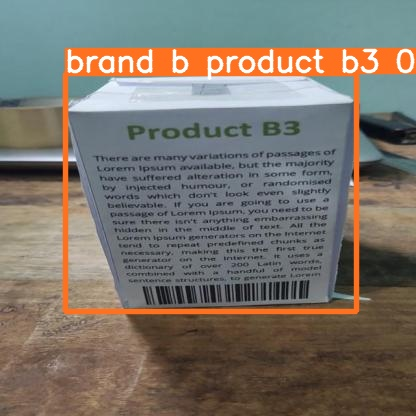

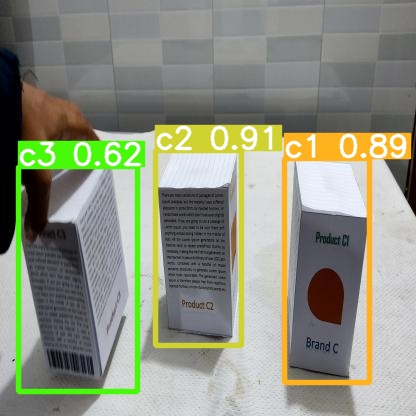

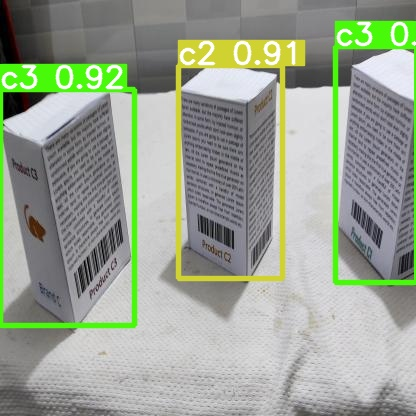

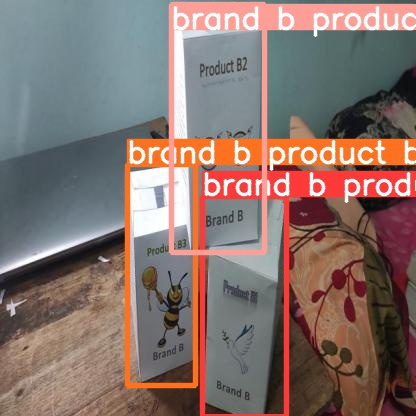

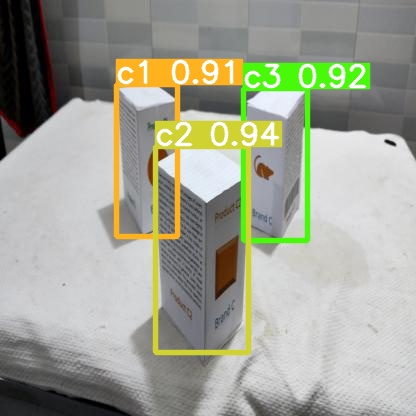

...

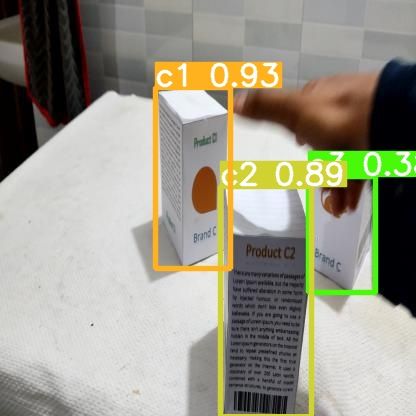

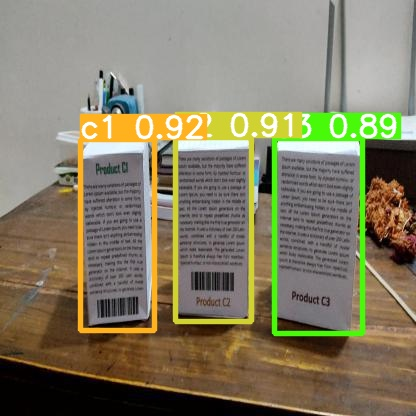

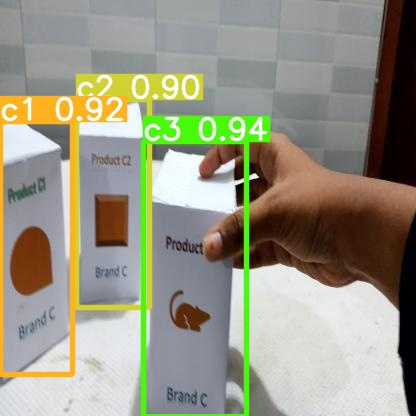

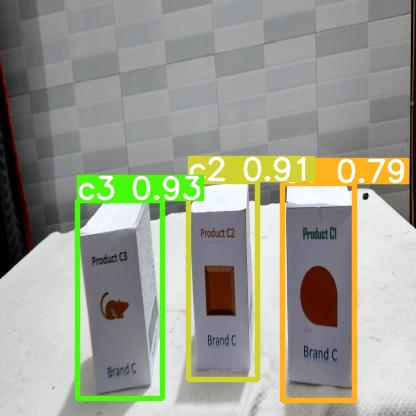

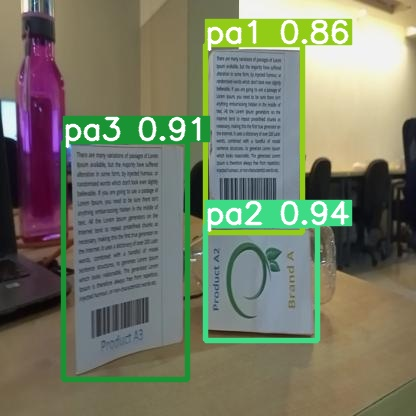

In [6]:
#display inference on ALL test images

import glob
from IPython.display import Image, display 

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [8]:
!python export.py --weights /content/yolov5/runs/train/exp/weights/best.pt --include tfjs

export: data=data/coco128.yaml, weights=['/content/yolov5/runs/train/exp/weights/best.pt'], imgsz=[640, 640], batch_size=1, device=cpu, half=False, inplace=False, train=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=12, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['tfjs']
YOLOv5 🚀 v6.1-13-g601dbb8 torch 1.10.0+cu111 CPU

Fusing layers... 
Model Summary: 213 layers, 7034398 parameters, 0 gradients, 15.9 GFLOPs

PyTorch: starting from /content/yolov5/runs/train/exp/weights/best.pt with output shape (1, 25200, 14) (14.4 MB)

TensorFlow SavedModel: starting export with tensorflow 2.8.0...

                 from  n    params  module                                  arguments                     
2022-03-04 12:37:51.913709: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
  0                -1  

In [9]:
!zip -r /content/web_model.zip /content/yolov5/runs/train/exp/weights/best_web_model

  adding: content/yolov5/runs/train/exp/weights/best_web_model/ (stored 0%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/group1-shard2of7.bin (deflated 7%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/model.json (deflated 94%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/group1-shard3of7.bin (deflated 7%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/group1-shard7of7.bin (deflated 8%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/group1-shard4of7.bin (deflated 7%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/group1-shard5of7.bin (deflated 7%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/group1-shard6of7.bin (deflated 7%)
  adding: content/yolov5/runs/train/exp/weights/best_web_model/group1-shard1of7.bin (deflated 8%)
